# 2110433 - Computer Vision (2023/2)

# Lab 9 - Modern Object Detection - MMDetection
In this lab, we will learn how to use Convolutional Neural Network on object detection problem by using famouse object detection framework <a href="https://github.com/open-mmlab/mmdetection">MMDetection</a>. This notebook is modified from official tutorial notebook.

Install prerequisite libraries for MMDetection
![mmdetection](https://raw.githubusercontent.com/open-mmlab/mmdetection/master/resources/mmdet-logo.png)

In [1]:
# Check nvcc version
!nvcc -V
# Check GCC version
!gcc --version
# Check Pytorch version
import torch
print(torch.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Wed_Nov_22_10:17:15_PST_2023
Cuda compilation tools, release 12.3, V12.3.107
Build cuda_12.3.r12.3/compiler.33567101_0
gcc (Ubuntu 11.4.0-1ubuntu1~22.04) 11.4.0
Copyright (C) 2021 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.

2.1.0+cu121


Install
- Pytorch 1.2.1
- mmengine
- mmcv
- mmdetection

In [2]:
# install dependencies:
# !pip install torch==2.1.0 torchvision==0.16.0 torchaudio==2.1.0 --index-url https://download.pytorch.org/whl/cu121
# !pip install -U openmim
# !mim install mmengine
# !mim install "mmcv==2.1.0"

# Install mmdetection
# !rm -rf mmdetection
# !git clone https://github.com/open-mmlab/mmdetection.git
# %cd mmdetection

# %pip install -e .

In [3]:
from mmengine.utils import get_git_hash
from mmengine.utils.dl_utils import collect_env as collect_base_env

import mmdet


def collect_env():
    """Collect the information of the running environments."""
    env_info = collect_base_env()
    env_info['MMDetection'] = f'{mmdet.__version__}+{get_git_hash()[:7]}'
    return env_info


if __name__ == '__main__':
    for name, val in collect_env().items():
        print(f'{name}: {val}')

sys.platform: linux
Python: 3.11.8 | packaged by conda-forge | (main, Feb 16 2024, 20:53:32) [GCC 12.3.0]
CUDA available: True
MUSA available: False
numpy_random_seed: 2147483648
GPU 0: NVIDIA GeForce RTX 4080
CUDA_HOME: /usr/local/cuda-12.3
NVCC: Cuda compilation tools, release 12.3, V12.3.107
GCC: gcc (Ubuntu 11.4.0-1ubuntu1~22.04) 11.4.0
PyTorch: 2.1.0+cu121
PyTorch compiling details: PyTorch built with:
  - GCC 9.3
  - C++ Version: 201703
  - Intel(R) oneAPI Math Kernel Library Version 2022.2-Product Build 20220804 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v3.1.1 (Git Hash 64f6bcbcbab628e96f33a62c3e975f8535a7bde4)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (usually provided by MKL)
  - NNPACK is enabled
  - CPU capability usage: AVX2
  - CUDA Runtime 12.1
  - NVCC architecture flags: -gencode;arch=compute_50,code=sm_50;-gencode;arch=compute_60,code=sm_60;-gencode;arch=compute_70,code=sm_70;-gencode;arch=compute_75,code=sm_75;-gencode;arch=compu

## Perform Inference with An MMDet detector

### An efficient Real-Time one-stage detector

In this tutorial, we use RTMDet, an efficient Real-Time one-stage detector as an example.

The high-level architecture of RTMDet is shown in the following picture. More details can be found in the [paper](https://arxiv.org/abs/2212.07784).

![RTMDet](https://user-images.githubusercontent.com/27466624/225922103-404064c1-3cb0-4ab5-9388-79f9517dcdb0.jpg)

To obtain a more efficient model architecture, MMDetection explore an architecture that has compatible capacities in the backbone and neck, constructed by a basic building block that consists of large-kernel depth-wise convolutions. MMDetection further introduce soft labels when calculating matching costs in the dynamic label assignment to improve accuracy. Together with better training techniques, the resulting object detector, named RTMDet, achieves 52.8% AP on COCO with 300+ FPS on an NVIDIA 3090 GPU, outperforming the current mainstream industrial detectors. RTMDet achieves the best parameter-accuracy trade-off with tiny/small/medium/large/extra-large model sizes for various application scenarios, and obtains new state-of-the-art performance on real-time instance segmentation and rotated object detection. We hope the experimental results can provide new insights into designing versatile real-time object detectors for many object recognition tasks.



In [4]:
# We download the pre-trained checkpoints for inference and finetuning.
# !mkdir ./checkpoints
# !mim download mmdet --config rtmdet_tiny_8xb32-300e_coco --dest ./checkpoints

### Config name style
We follow the below style to name config files. Contributors are advised to follow the same style.



```
{algorithm name}_{model component names [component1]_[component2]_[...]}_{training settings}_{training dataset information}_{testing dataset information}.py

```




### Inference the detector

Since the model is successfully created and loaded, let's see how good it is. We use the high-level API `DetInferencer` implemented in the MMDetection. This API is created to ease the inference process. The details of the codes can be found [here](https://github.com/open-mmlab/mmdetection/blob/dev-3.x/mmdet/apis/det_inferencer.py).

In [5]:
from mmdet.apis import DetInferencer

# Choose to use a config
model_name = 'rtmdet_tiny_8xb32-300e_coco'
# Setup a checkpoint file to load
checkpoint = './checkpoints/rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth'

# Set the device to be used for evaluation
device = 'cuda:0'

# Initialize the DetInferencer
inferencer = DetInferencer(model_name, checkpoint, device)

# Use the detector to do inference
img = './mmdetection/demo/demo.jpg'
result = inferencer(img, out_dir='./output')

Loads checkpoint by local backend from path: ./checkpoints/rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth
The model and loaded state dict do not match exactly

unexpected key in source state_dict: data_preprocessor.mean, data_preprocessor.std

03/29 21:23:14 - mmengine - WARNING - Failed to search registry with scope "mmdet" in the "function" registry tree. As a workaround, the current "function" registry in "mmengine" is used to build instance. This may cause unexpected failure when running the built modules. Please check whether "mmdet" is a correct scope, or whether the registry is initialized.


/home/andre/anaconda3/envs/CV2/lib/python3.11/site-packages/rich/live.py:231: UserWarning: install "ipywidgets" for
Jupyter support
  warnings.warn('install "ipywidgets" for Jupyter support')

/home/andre/anaconda3/envs/CV2/lib/python3.11/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: 
in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at 
../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]

/home/andre/anaconda3/envs/CV2/lib/python3.11/site-packages/mmengine/visualization/visualizer.py:196: UserWarning: Failed to add <class 'mmengine.visualization.vis_backend.LocalVisBackend'>, please provide the `save_dir` argument.
  warnings.warn(f'Failed to add {vis_backend.__class__}, '


In [6]:
# Show the structure of result dict
from rich.pretty import pprint
pprint(result, max_length=4)

{
│   'predictions': [
│   │   {
│   │   │   'labels': [13, 2, 2, 2, ... +296],
│   │   │   'scores': [0.8702742457389832, 0.7680311799049377, 0.7431980967521667, 0.699695348739624, ... +296],
│   │   │   'bboxes': [
│   │   │   │   [221.3555908203125, 176.13182067871094, 456.25628662109375, 383.2632141113281],
│   │   │   │   [295.3547668457031, 117.18452453613281, 378.5780944824219, 150.26316833496094],
│   │   │   │   [190.57810974121094, 109.7108383178711, 299.52197265625, 155.03404235839844],
│   │   │   │   [431.3676452636719, 104.98279571533203, 484.8753356933594, 131.94161987304688],
│   │   │   │   ... +296
│   │   │   ]
│   │   }
│   ],
│   'visualization': [
│   │   array([[[ 28,  48,  13],
│   │   [ 37,  63,  28],
│   │   [ 30,  64,  27],
│   │   ...,
│   │   [ 23,  47,  31],
│   │   [ 31,  67,  31],
│   │   [ 54,  92,  17]],
│      
│      [[ 23,  42,   0],
│   │   [ 25,  50,   8],
│   │   [ 30,  62,  21],
│   │   ...,
│   │   [ 92, 114, 102],
│   │   [ 16,  53,  12],
│   │   [ 44,  75,  16]],
│      
│      [[ 20,  50,   0],
│   │   [ 25,  59,   8],
│   │   [ 29,  66,  23],
│   │   ...,
│   │   [ 47,  70,  44],
│   │   [ 29,  60,  18],
│   │   [ 54,  77,  31]],
│      
│      ...,
│      
│      [[ 63,  68,  45],
│   │   [ 58,  66,  27],
│   │   [ 74,  84,  49],
│   │   ...,
│   │   [ 32,  46,  23],
│   │   [ 56,  76,  39],
│   │   [ 31,  47,  18]],
│      
│      [[ 60,  66,  40],
│   │   [ 45,  55,  18],
│   │   [ 83,  92,  61],
│   │   ...,
│   │   [ 63,  77,  54],
│   │   [ 47,  67,  30],
│   │   [ 35,  52,  20]],
│      
│      [[ 64,  70,  42],
│   │   [ 85,  95,  60],
│   │   [ 66,  75,  48],
│   │   ...,
│   │   [ 37,  51,  28],
│   │   [ 59,  79,  42],
│   │   [ 44,  61,  29]]], dtype=uint8)
│   ]
}

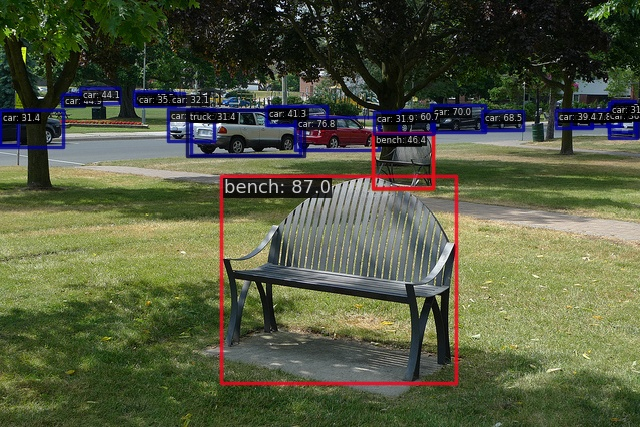

In [7]:
# Show the output image
from PIL import Image
Image.open('./output/vis/demo.jpg')

## Train with customized datasets

In this part, you will know how to train predefined models with customized datasets and then test it. We use the [balloon dataset](https://github.com/matterport/Mask_RCNN/tree/master/samples/balloon) as an example to describe the whole process.

The basic steps are as below:

1. Prepare the customized dataset
2. Prepare a config
3. Train, test, and infer models on the customized dataset.


### Prepare the customized dataset

There are three ways to support a new dataset in MMDetection:

1. Reorganize the dataset into COCO format.
2. Reorganize the dataset into a middle format.
3. Implement a new dataset.

Usually, we recommend using the first two methods which are usually easier than the third.

In this tutorial, we use the ballon dataset an example of converting the data into COCO format.

**Note**: Datasets and metrics have been decoupled except CityScapes since MMDetection 3.0. Therefore, users can use any kind of evaluation metrics for any format of datasets during validation. For example: evaluate on COCO dataset with VOC metric, or evaluate on OpenImages dataset with both VOC and COCO metrics.

In [8]:
# Download the data and unzip it
# !python mmdetection/tools/misc/download_dataset.py --dataset-name balloon --save-dir data --unzip

#### COCO annotation format
The necessary keys of COCO format for instance segmentation are as below, for the complete details, please refer [here](https://cocodataset.org/#format-data).

```json
{
    "images": [image],
    "annotations": [annotation],
    "categories": [category]
}
image = {
    "id": int,
    "width": int,
    "height": int,
    "file_name": str,
}
annotation = {
    "id": int,
    "image_id": int,
    "category_id": int,
    "segmentation": RLE or [polygon],
    "area": float,
    "bbox": [x,y,width,height], # (x, y) are the coordinates of the upper left corner of the bbox
    "iscrowd": 0 or 1,
}
categories = [{
    "id": int,
    "name": str,
    "supercategory": str,
}]
```

Assume we use the balloon dataset.
After downloading the data, we need to implement a function to convert the annotation format into the COCO format. Then we can use implemented `CocoDataset` to load the data and perform training and evaluation.

If you take a look at the dataset, you will find the dataset format is as below:

```json
{'base64_img_data': '',
 'file_attributes': {},
 'filename': '34020010494_e5cb88e1c4_k.jpg',
 'fileref': '',
 'regions': {'0': {'region_attributes': {},
   'shape_attributes': {'all_points_x': [1020,
     1000,
     994,
     1003,
     1023,
     1050,
     1089,
     1134,
     1190,
     1265,
     1321,
     1361,
     1403,
     1428,
     1442,
     1445,
     1441,
     1427,
     1400,
     1361,
     1316,
     1269,
     1228,
     1198,
     1207,
     1210,
     1190,
     1177,
     1172,
     1174,
     1170,
     1153,
     1127,
     1104,
     1061,
     1032,
     1020],
    'all_points_y': [963,
     899,
     841,
     787,
     738,
     700,
     663,
     638,
     621,
     619,
     643,
     672,
     720,
     765,
     800,
     860,
     896,
     942,
     990,
     1035,
     1079,
     1112,
     1129,
     1134,
     1144,
     1153,
     1166,
     1166,
     1150,
     1136,
     1129,
     1122,
     1112,
     1084,
     1037,
     989,
     963],
    'name': 'polygon'}}},
 'size': 1115004}
```

The annotation is a JSON file where each key indicates an image's all annotations.
The code to convert the balloon dataset into coco format is as below.

Using the function below, users can successfully convert the annotation file into json format, then we can use `CocoDataset` to train and evaluate the model with `CocoMetric`.

In [9]:
import os.path as osp
import mmcv
from mmengine.fileio import dump, load
from mmengine.utils import track_iter_progress

def convert_balloon_to_coco(ann_file, out_file, image_prefix):
    data_infos = load(ann_file)

    annotations = []
    images = []
    obj_count = 0
    for idx, v in enumerate(track_iter_progress(list(data_infos.values()))):
        filename = v['filename']
        img_path = osp.join(image_prefix, filename)
        height, width = mmcv.imread(img_path).shape[:2]

        images.append(
            dict(id=idx, file_name=filename, height=height, width=width))

        for _, obj in v['regions'].items():
            assert not obj['region_attributes']
            obj = obj['shape_attributes']
            px = obj['all_points_x']
            py = obj['all_points_y']
            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]

            x_min, y_min, x_max, y_max = (min(px), min(py), max(px), max(py))

            data_anno = dict(
                image_id=idx,
                id=obj_count,
                category_id=0,
                bbox=[x_min, y_min, x_max - x_min, y_max - y_min],
                area=(x_max - x_min) * (y_max - y_min),
                segmentation=[poly],
                iscrowd=0)
            annotations.append(data_anno)
            obj_count += 1

    coco_format_json = dict(
        images=images,
        annotations=annotations,
        categories=[{
            'id': 0,
            'name': 'balloon'
        }])
    dump(coco_format_json, out_file)

if __name__ == '__main__':
    convert_balloon_to_coco(ann_file='data/balloon/train/via_region_data.json',
                            out_file='data/balloon/train.json',
                            image_prefix='data/balloon/train')
    convert_balloon_to_coco(ann_file='data/balloon/val/via_region_data.json',
                            out_file='data/balloon/val.json',
                            image_prefix='data/balloon/val')

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 61/61, 89.1 task/s, elapsed: 1s, ETA:     0s
[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 13/13, 81.4 task/s, elapsed: 0s, ETA:     0s


## Prepare a config

The second step is to prepare a config thus the dataset could be successfully loaded. Assume that we want to use RTMDet-tiny, the config to train the detector on balloon dataset is as below. Assume the config is under directory `configs/rtmdet/` and named as `rtmdet_tiny_1xb4-20e_balloon.py`, the config is as below.


In [10]:
config_balloon = """
# Inherit and overwrite part of the config based on this config
_base_ = './rtmdet_tiny_8xb32-300e_coco.py'

data_root = 'data/balloon/' # dataset root

train_batch_size_per_gpu = 4
train_num_workers = 2

max_epochs = 20
stage2_num_epochs = 1
base_lr = 0.00008


metainfo = {
    'classes': ('balloon', ),
    'palette': [
        (220, 20, 60),
    ]
}

train_dataloader = dict(
    batch_size=train_batch_size_per_gpu,
    num_workers=train_num_workers,
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        data_prefix=dict(img='train/'),
        ann_file='train.json'))

val_dataloader = dict(
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        data_prefix=dict(img='val/'),
        ann_file='val.json'))

test_dataloader = val_dataloader

val_evaluator = dict(ann_file=data_root + 'val.json')

test_evaluator = val_evaluator

model = dict(bbox_head=dict(num_classes=1))

# learning rate
param_scheduler = [
    dict(
        type='LinearLR',
        start_factor=1.0e-5,
        by_epoch=False,
        begin=0,
        end=10),
    dict(
        # use cosine lr from 10 to 20 epoch
        type='CosineAnnealingLR',
        eta_min=base_lr * 0.05,
        begin=max_epochs // 2,
        end=max_epochs,
        T_max=max_epochs // 2,
        by_epoch=True,
        convert_to_iter_based=True),
]

train_pipeline_stage2 = [
    dict(type='LoadImageFromFile', backend_args=None),
    dict(type='LoadAnnotations', with_bbox=True),
    dict(
        type='RandomResize',
        scale=(640, 640),
        ratio_range=(0.1, 2.0),
        keep_ratio=True),
    dict(type='RandomCrop', crop_size=(640, 640)),
    dict(type='YOLOXHSVRandomAug'),
    dict(type='RandomFlip', prob=0.5),
    dict(type='Pad', size=(640, 640), pad_val=dict(img=(114, 114, 114))),
    dict(type='PackDetInputs')
]

# optimizer
optim_wrapper = dict(
    _delete_=True,
    type='OptimWrapper',
    optimizer=dict(type='AdamW', lr=base_lr, weight_decay=0.05),
    paramwise_cfg=dict(
        norm_decay_mult=0, bias_decay_mult=0, bypass_duplicate=True))

default_hooks = dict(
    checkpoint=dict(
        interval=5,
        max_keep_ckpts=2,  # only keep latest 2 checkpoints
        save_best='auto'
    ),
    logger=dict(type='LoggerHook', interval=5))

custom_hooks = [
    dict(
        type='PipelineSwitchHook',
        switch_epoch=max_epochs - stage2_num_epochs,
        switch_pipeline=train_pipeline_stage2)
]

# load COCO pre-trained weight
load_from = './checkpoints/rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth'

train_cfg = dict(type='EpochBasedTrainLoop', max_epochs=max_epochs, val_interval=1)
visualizer = dict(vis_backends=[dict(type='LocalVisBackend'),dict(type='TensorboardVisBackend')])
"""

with open('./mmdetection/configs/rtmdet/rtmdet_tiny_1xb4-20e_balloon.py', 'w') as f:
    f.write(config_balloon)

In [11]:
# !python mmdetection/tools/train.py mmdetection/configs/rtmdet/rtmdet_tiny_1xb4-20e_balloon.py

### Understand the log
From the log, we can have a basic understanding on the training process and know how well the detector is trained.

First, since the dataset we are using is small, we loaded a pre-trained Faster R-CNN model and fine-tune it for detection.
The original Faster R-CNN is trained on COCO dataset that contains 80 classes but KITTI Tiny dataset only have 3 classes. Therefore, the last FC layers of the pre-trained Faster R-CNN for classification and regression have different weight shape and are not used.

Second, after training, the detector is evaluated by the default VOC-style evaluation. The results show that the detector achieves 58.1 mAP on the val dataset, not bad!

We can also check the tensorboard to see the curves.

In [12]:
# load tensorboard in colab
%load_ext tensorboard

# see curves in tensorboard
%tensorboard --logdir ./work_dirs

Launching TensorBoard...

From the tensorboard, we can observe that changes of loss and learning rate. We can see the losses of each branch gradually decrease as the training goes by.

## Test the Trained Detector

After finetuning the detector, let's visualize the prediction results!

In [13]:
from mmdet.apis import DetInferencer
import glob

# Choose to use a config
config = './mmdetection/configs/rtmdet/rtmdet_tiny_1xb4-20e_balloon.py'
# Setup a checkpoint file to load
checkpoint = glob.glob('./work_dirs/rtmdet_tiny_1xb4-20e_balloon/best_coco*.pth')[0]

# Set the device to be used for evaluation
device = 'cuda:0'

# Initialize the DetInferencer
inferencer = DetInferencer(config, checkpoint, device)

# Use the detector to do inference
img = './data/balloon/val/4838031651_3e7b5ea5c7_b.jpg'
result = inferencer(img, out_dir='./output')

/home/andre/anaconda3/envs/CV2/lib/python3.11/site-packages/rich/live.py:231: UserWarning: install "ipywidgets" for
Jupyter support
  warnings.warn('install "ipywidgets" for Jupyter support')

Loads checkpoint by local backend from path: ./work_dirs/rtmdet_tiny_1xb4-20e_balloon/best_coco_bbox_mAP_epoch_19.pth


/home/andre/anaconda3/envs/CV2/lib/python3.11/site-packages/mmengine/visualization/visualizer.py:196: UserWarning: Failed to add <class 'mmengine.visualization.vis_backend.LocalVisBackend'>, please provide the `save_dir` argument.
  warnings.warn(f'Failed to add {vis_backend.__class__}, '
/home/andre/anaconda3/envs/CV2/lib/python3.11/site-packages/mmengine/visualization/visualizer.py:196: UserWarning: Failed to add <class 'mmengine.visualization.vis_backend.TensorboardVisBackend'>, please provide the `save_dir` argument.
  warnings.warn(f'Failed to add {vis_backend.__class__}, '


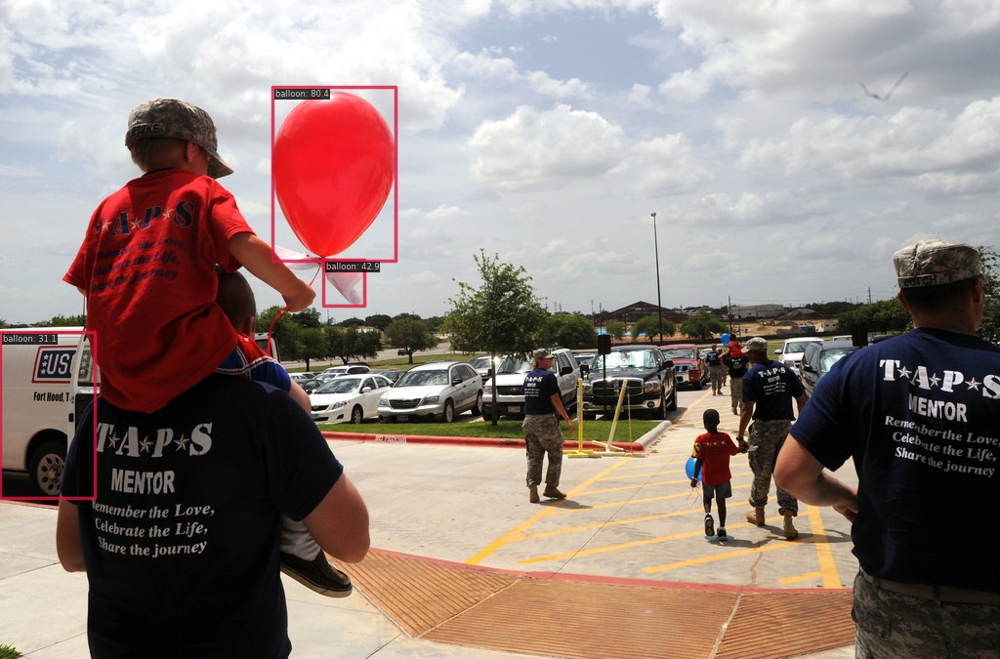

In [14]:
# Show the output image
Image.open('./output/vis/4838031651_3e7b5ea5c7_b.jpg')

# Lab 9 - Modern Object Detection - YOLOv8
In this section, we will learn how to use Yolov8 to detect object in Racoon dataset and Red blood cell dataset

In [15]:
# Install the ultralytics package from PyPI
# !pip install ultralytics

In [16]:
from ultralytics import YOLO


# Raccoon Dataset
![Raccoon Dataset](https://i.imgur.com/cRQJ1PB.png)

Dataset URL : https://github.com/datitran/raccoon_dataset <br>
This dataset contains 196 images of raccoons and 213 bounding boxes (some images contain two raccoons). This is a single class problem, and images various size and scene condition. It's a great first dataset for getting started with object detection.



Download and extract preprocessed dataset from lab server

In [17]:
# !wget http://piclab.ai/classes/cv2023/raccoons.zip
# !unzip -qo raccoons.zip

### Dataset Exploration
We will use Fiftyone library to visualize our dataset

In [18]:
# !pip install fiftyone

In [19]:
import fiftyone as fo

name = "racoons_train"
dataset = fo.load_dataset(name)
dataset.delete()

# Create the dataset
dataset = fo.Dataset.from_dir(
    dataset_dir='raccoons/train',
    dataset_type=fo.types.YOLOv5Dataset,
    name=name,
)


 100% |█████████████████████| 0/0 [590.4us elapsed, ? remaining, ? samples/s] 



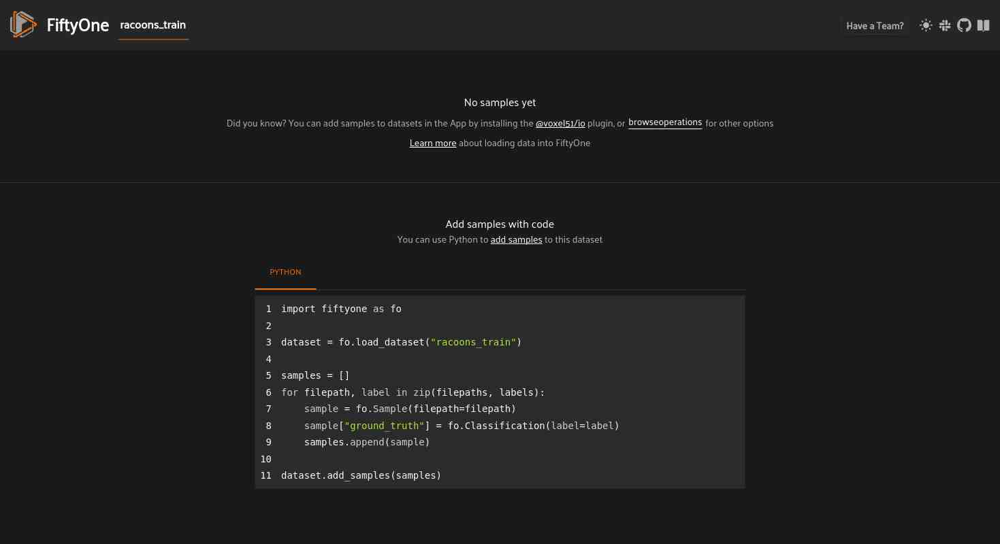

In [20]:
# Launch a new App instance with a customized config
app_config = fo.AppConfig()
app_config.show_attributes = True

session = fo.launch_app(dataset, config=app_config)


In [21]:
for sample in dataset:
    print(sample)
    break

### Training

In [22]:
# Load a pretrained YOLO model (recommended for training)
model = YOLO('yolov8n.pt')
results = model.train(data='./raccoons/dataset.yaml', epochs=10)

Ultralytics YOLOv8.1.37 🚀 Python-3.11.8 torch-2.1.0+cu121 CUDA:0 (NVIDIA GeForce RTX 4080, 16071MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=./raccoons/dataset.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=

train: Scanning /home/andre/Desktop/CU_submission/chulacv2023/Lab9/raccoons/train/labels/val.cache... 156 images, 0 backgrounds, 0 corrupt: 100%|██████████| 156/156 [00:00<?, ?it/s]
val: Scanning /home/andre/Desktop/CU_submission/chulacv2023/Lab9/raccoons/test/labels/val.cache... 156 images, 0 backgrounds, 0 corrupt: 100%|██████████| 156/156 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      2.24G      1.341      3.247      1.911         14        640: 100%|██████████| 10/10 [00:01<00:00,  8.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.08it/s]

                   all        156        169    0.00355      0.982      0.606      0.232



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      2.16G      1.141      2.402      1.743         12        640: 100%|██████████| 10/10 [00:00<00:00, 22.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 16.95it/s]


                   all        156        169    0.00357      0.988      0.555      0.267

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      2.12G      1.056      2.132       1.62         13        640: 100%|██████████| 10/10 [00:00<00:00, 23.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 18.29it/s]

                   all        156        169      0.698      0.651      0.672      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      2.12G      1.071      2.007      1.672         14        640: 100%|██████████| 10/10 [00:00<00:00, 23.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 16.48it/s]

                   all        156        169      0.791      0.247      0.587      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      2.12G      1.116      1.933      1.689         13        640: 100%|██████████| 10/10 [00:00<00:00, 23.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 17.90it/s]

                   all        156        169      0.805      0.122      0.531      0.246



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      2.12G      1.098       1.94      1.692         13        640: 100%|██████████| 10/10 [00:00<00:00, 22.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 16.01it/s]

                   all        156        169       0.74       0.55      0.659      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      2.12G      1.004      1.724      1.543         13        640: 100%|██████████| 10/10 [00:00<00:00, 24.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 18.27it/s]

                   all        156        169      0.882      0.811      0.897      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      2.12G      1.005      1.585      1.563         13        640: 100%|██████████| 10/10 [00:00<00:00, 24.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 18.41it/s]

                   all        156        169      0.904      0.837      0.913      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      2.12G     0.9579      1.574      1.502         12        640: 100%|██████████| 10/10 [00:00<00:00, 24.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 18.91it/s]

                   all        156        169      0.944        0.9      0.954      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      2.12G      0.937      1.495      1.454         12        640: 100%|██████████| 10/10 [00:00<00:00, 23.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00, 18.77it/s]

                   all        156        169      0.957      0.917      0.962      0.698



10 epochs completed in 0.004 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.1.37 🚀 Python-3.11.8 torch-2.1.0+cu121 CUDA:0 (NVIDIA GeForce RTX 4080, 16071MiB)
Model summary (fused): 168 layers, 3005843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.94it/s]


                   all        156        169      0.958      0.917      0.963      0.699
Speed: 0.1ms preprocess, 0.6ms inference, 0.0ms loss, 2.0ms postprocess per image
Results saved to runs/detect/train


In [26]:
# load tensorboard in colab
%load_ext tensorboard

# see curves in tensorboard
%tensorboard --logdir ./runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6008 (pid 34792), started 0:00:05 ago. (Use '!kill 34792' to kill it.)

### Inference on image!


0: 640x640 1 racoons, 1.0ms
1: 640x640 2 racoonss, 1.0ms
2: 640x640 1 racoons, 1.0ms
Speed: 0.8ms preprocess, 1.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)


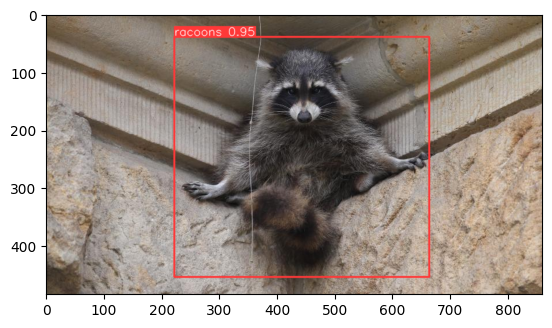

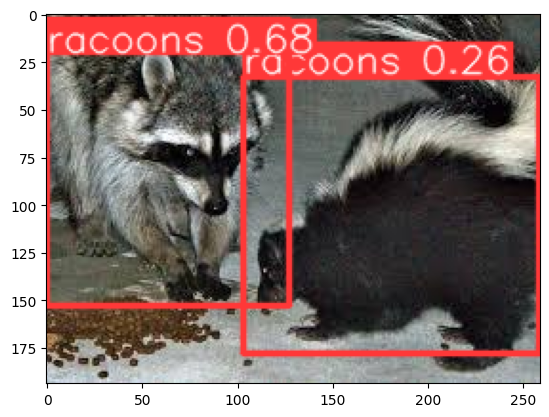

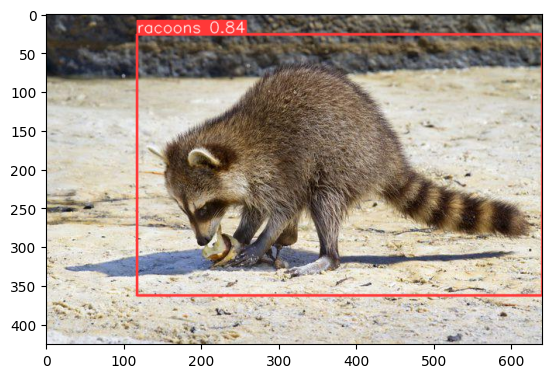

In [35]:
from PIL import Image
# %matplotlib inline
import matplotlib.pyplot as plt

# from google.colab.patches import cv2_imshow

model = YOLO('./runs/detect/train/weights/best.pt')
# Run batched inference on a list of images
results = model(['./raccoons/test/images/val/raccoon-66_jpg.rf.f9afd156c04ad46cccc09ae410ecb550.jpg',
                 './raccoons/test/images/val/raccoon-102_jpg.rf.915f37fb3fa57ba4d81cf8a7c35a8036.jpg',
                 './raccoons/test/images/val/raccoon-71_jpg.rf.ae2ddcdf7ae5067983fd39b8e4c6771f.jpg'])  # return a list of Results objects

# Visualize the results
for i, r in enumerate(results):
    # print(r)
    # Plot results image
    im_bgr = r.plot()  # BGR-order numpy array
    im_rgb = Image.fromarray(im_bgr[..., ::-1])  # RGB-order PIL image

    # Show results to screen (in supported environments)
    plt.imshow(im_rgb)
    plt.show()


# Chula-RBC Dataset
![RBC Dataset](https://raw.githubusercontent.com/Chula-PIC-Lab/Chula-RBC-12-Dataset/main/Dataset/1.jpg)

Dataset URL : https://github.com/Chula-PIC-Lab/Chula-RBC-12-Dataset <br>

In [36]:
# !wget https://piclab.ai/classes/cv2023/redbloodcell.zip
# !unzip -q redbloodcell.zip

--2024-03-29 21:35:38--  https://piclab.ai/classes/cv2023/redbloodcell.zip
Resolving piclab.ai (piclab.ai)... 161.200.92.132
Connecting to piclab.ai (piclab.ai)|161.200.92.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 78565658 (75M) [application/zip]
Saving to: ‘redbloodcell.zip’

redbloodcell.zip    100%[===================>]  74.93M  11.4MB/s    in 7.7s    

2024-03-29 21:35:45 (9.75 MB/s) - ‘redbloodcell.zip’ saved [78565658/78565658]



### Dataset Exploration
We will use pycocotools to explore this dataset.

In [37]:
import fiftyone as fo

name = "rbc"
# dataset = fo.load_dataset(name)
# dataset.delete()

# Create the dataset
dataset = fo.Dataset.from_dir(
    dataset_dir='redbloodcell',
    dataset_type=fo.types.YOLOv5Dataset,
    name=name,
)

 100% |█████████████████████| 0/0 [720.3us elapsed, ? remaining, ? samples/s] 


In [38]:
# Launch a new App instance with a customized config
app_config = fo.AppConfig()
app_config.show_attributes = True

session = fo.launch_app(dataset, config=app_config)

### Training

In [42]:
from ultralytics import YOLO

# Load a pretrained YOLO model (recommended for training)
model = YOLO('yolov8n.pt')
results = model.train(data='./redbloodcell/dataset.yaml', epochs=10)

Ultralytics YOLOv8.1.37 🚀 Python-3.11.8 torch-2.1.0+cu121 CUDA:0 (NVIDIA GeForce RTX 4080, 16071MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=./redbloodcell/dataset.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_

train: Scanning /home/andre/Desktop/CU_submission/chulacv2023/Lab9/redbloodcell/labels/val... 738 images, 0 backgrounds, 0 corrupt: 100%|██████████| 738/738 [00:00<00:00, 3362.08it/s]

train: New cache created: /home/andre/Desktop/CU_submission/chulacv2023/Lab9/redbloodcell/labels/val.cache



val: Scanning /home/andre/Desktop/CU_submission/chulacv2023/Lab9/redbloodcell/labels/val.cache... 738 images, 0 backgrounds, 0 corrupt: 100%|██████████| 738/738 [00:00<?, ?it/s]


Plotting labels to runs/detect/train5/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000769, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train5
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      3.99G      0.712       3.86     0.9299        155        640: 100%|██████████| 47/47 [00:03<00:00, 12.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:02<00:00,  9.68it/s]


                   all        738      65800     0.0856      0.331     0.0883     0.0627

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      3.53G      0.672      2.619     0.8897        174        640: 100%|██████████| 47/47 [00:02<00:00, 18.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.90it/s]


                   all        738      65800      0.189      0.566      0.229      0.195

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      3.83G     0.6223      1.936      0.881        164        640: 100%|██████████| 47/47 [00:02<00:00, 19.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.52it/s]


                   all        738      65800      0.527      0.382      0.385      0.339

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      3.82G     0.5837      1.601     0.8758        170        640: 100%|██████████| 47/47 [00:02<00:00, 18.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.12it/s]


                   all        738      65800       0.42      0.507      0.446      0.401

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      4.23G     0.5592      1.449     0.8679        146        640: 100%|██████████| 47/47 [00:02<00:00, 18.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.47it/s]

                   all        738      65800      0.384      0.593      0.497      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      3.44G     0.5422      1.339      0.861        175        640: 100%|██████████| 47/47 [00:02<00:00, 18.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.40it/s]


                   all        738      65800       0.44      0.578      0.543      0.486

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      3.56G     0.5299      1.259     0.8584        171        640: 100%|██████████| 47/47 [00:02<00:00, 19.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.49it/s]


                   all        738      65800      0.463      0.585      0.568      0.513

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      4.04G     0.5166      1.196     0.8534        181        640: 100%|██████████| 47/47 [00:02<00:00, 18.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.33it/s]


                   all        738      65800      0.531      0.599      0.598      0.539

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      3.75G     0.5015      1.147     0.8523        203        640: 100%|██████████| 47/47 [00:02<00:00, 19.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.60it/s]


                   all        738      65800      0.518      0.636      0.611      0.553

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10       4.3G     0.4981      1.115      0.848        177        640: 100%|██████████| 47/47 [00:02<00:00, 18.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  6.77it/s]


                   all        738      65800      0.552       0.66      0.642       0.58

10 epochs completed in 0.018 hours.
Optimizer stripped from runs/detect/train5/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train5/weights/best.pt, 6.2MB

Validating runs/detect/train5/weights/best.pt...
Ultralytics YOLOv8.1.37 🚀 Python-3.11.8 torch-2.1.0+cu121 CUDA:0 (NVIDIA GeForce RTX 4080, 16071MiB)
Model summary (fused): 168 layers, 3007403 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.86it/s]


                   all        738      65800      0.552       0.66      0.642       0.58
                Normal        738      20835      0.639      0.865      0.812      0.754
         Uncategorised        738      16071      0.532      0.881      0.789       0.72
            Spherocyte        738      11188      0.713      0.803      0.825      0.727
             Macrocyte        738       2028      0.495      0.441      0.452      0.416
           Schistocyte        738       2070      0.361      0.506      0.383      0.307
             Microcyte        738       1565      0.392     0.0606      0.182      0.158
           Hypochromia        738       4062      0.586      0.585      0.616      0.551
           Target cell        738       6915      0.646       0.81      0.812      0.728
           Elliptocyte        738       1066      0.602       0.99      0.906      0.856
Speed: 0.1ms preprocess, 0.3ms inference, 0.0ms loss, 4.5ms postprocess per image
Results saved to runs/detect

### Inference on image!

0: 480x640 112 Normals, 11 Uncategoriseds, 2 Spherocytes, 29.8ms
1: 480x640 101 Normals, 20 Uncategoriseds, 2 Spherocytes, 29.8ms
Speed: 0.5ms preprocess, 29.8ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


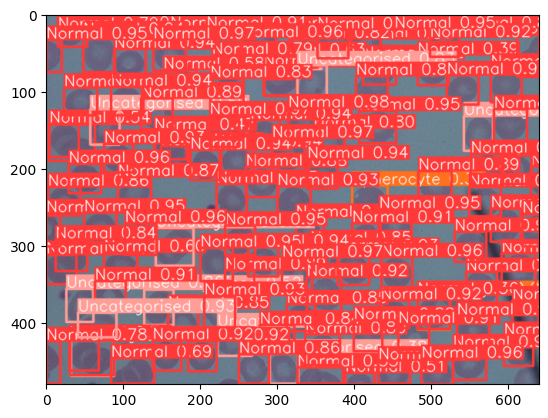

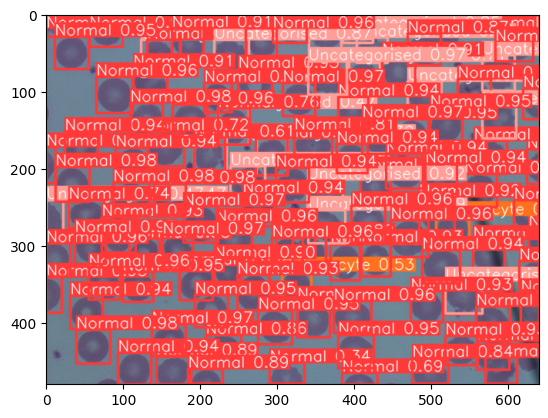

In [44]:
from PIL import Image
import matplotlib.pyplot as plt

model = YOLO('./runs/detect/train5/weights/best.pt')
# Run batched inference on a list of images
results = model(['./redbloodcell/images/val/1.jpg',
                 './redbloodcell/images/val/10.jpg',])  # return a list of Results objects

# Visualize the results
for i, r in enumerate(results):
    # print(r)
    # Plot results image
    im_bgr = r.plot()  # BGR-order numpy array
    im_rgb = Image.fromarray(im_bgr[..., ::-1])  # RGB-order PIL image

    # Show results to screen (in supported environments)
    plt.imshow(im_rgb)
    plt.show()